<a href="https://colab.research.google.com/github/shobhitsundriyal/GANsta/blob/master/Generating_faces.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!wget "https://storage.googleapis.com/kaggle-data-sets/29561/37705/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1581681766&Signature=mn11%2B0pmu80AQ57j41C5PtlubWykHW76Yh6mKJXISXZop5hB%2FFG8D05pscOmWAL7hvTHbRJeOJoJaKwsERDf%2BqQYQWzWEpOCc%2BUdSMRQ6pl1%2F1TPpb3RNDQZwTNjERNhj3cUx%2FRD4shQgmGHJdg57Q7SCaN0LES02xu%2FQw%2BKjLLJnSsQTUt9CRM9cxBmC2s9KHS7lYfo9qhYFSq5zcO6vmlJx%2FcWbbXpjB6s1o6XvnvwpLXpsQhIsPqZpxLrHru627xdii%2FT285bD0l97VbDbSyfQ6KhaKn4iqaGqGlogJSPUOaLMownbIwSobMm5hKXnbaTsEoTTd5aBEM926OyPg%3D%3D&response-content-disposition=attachment%3B+filename%3Dceleba-dataset.zip"

The name is too long, 528 chars total.
Trying to shorten...
New name is archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1581681766&Signature=mn11+0pmu80AQ57j41C5PtlubWykHW76Yh6mKJXISXZop5hB%2FFG8D05pscOmWAL7hvTHbRJeOJoJaKwsERDf+qQYQWzWEpOCc+UdSMRQ6pl1%2F1TPpb3RNDQZwTNjERNhj.
--2020-02-11 12:21:01--  https://storage.googleapis.com/kaggle-data-sets/29561/37705/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1581681766&Signature=mn11%2B0pmu80AQ57j41C5PtlubWykHW76Yh6mKJXISXZop5hB%2FFG8D05pscOmWAL7hvTHbRJeOJoJaKwsERDf%2BqQYQWzWEpOCc%2BUdSMRQ6pl1%2F1TPpb3RNDQZwTNjERNhj3cUx%2FRD4shQgmGHJdg57Q7SCaN0LES02xu%2FQw%2BKjLLJnSsQTUt9CRM9cxBmC2s9KHS7lYfo9qhYFSq5zcO6vmlJx%2FcWbbXpjB6s1o6XvnvwpLXpsQhIsPqZpxLrHru627xdii%2FT285bD0l97VbDbSyfQ6KhaKn4iqaGqGlogJSPUOaLMownbIwSobMm5hKXnbaTsEoTTd5aBEM926OyPg%3D%3D&response-content-disposition=attachment%3B+filename%3Dceleba-dataset.zip
Resolving storage.googleapis.com (storage.googleapis.

In [0]:
!unzip imgs.zip -d Data

In [0]:
import os 
import sys

import numpy as np
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import utils

In [0]:
CUDA = True
DATA_PATH = 'Data/img_align_celeba/'
OUT_PATH = 'output'
LOG_FILE = os.path.join(OUT_PATH, 'log.txt')
BATCH_SIZE = 128
IMAGE_CHANNEL = 3
Z_DIM = 1
G_HIDDEN = 64
X_DIM = 64
D_HIDDEN = 64
EPOCH_NUM = 25
REAL_LABEL = 1
FAKE_LABEL = 0
lr = 2e-4
seed = 1

In [5]:
utils.clear_folder(OUT_PATH)
print("Logging to {}\n".format(LOG_FILE))
#sys.stdout = utils.StdOut(LOG_FILE)
CUDA = CUDA and torch.cuda.is_available()
print("PyTorch version: {}".format(torch.__version__))
if CUDA:
    print("CUDA version: {}\n".format(torch.version.cuda))
if seed is None:
    seed = np.random.randint(1, 10000)
print("Random Seed: ", seed)
np.random.seed(seed)
torch.manual_seed(seed)
if CUDA:
    torch.cuda.manual_seed(seed)
cudnn.benchmark = True
device = torch.device("cuda:0" if CUDA else "cpu")

Logging to output/log.txt

PyTorch version: 1.4.0
CUDA version: 10.1

Random Seed:  1


In [0]:
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()  #-w
    
    self.main = nn.Sequential(
        #layer 1
        nn.ConvTranspose2d(Z_DIM, G_HIDDEN*8, kernel_size=4, stride=1, padding=0, bias=False),
        nn.BatchNorm2d(G_HIDDEN*8),
        nn.ReLU(True),
        #layer 2
        nn.ConvTranspose2d(G_HIDDEN*8, G_HIDDEN*4, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(G_HIDDEN*4),
        nn.ReLU(True),
        #layer 3
        nn.ConvTranspose2d(G_HIDDEN*4, G_HIDDEN*2, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(G_HIDDEN*2),
        nn.ReLU(True),
        #layer 4
        nn.ConvTranspose2d(G_HIDDEN*2, G_HIDDEN, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(G_HIDDEN),
        nn.ReLU(True),
        #output layer
        nn.ConvTranspose2d(G_HIDDEN, IMAGE_CHANNEL, 4, 2, 1, bias=False),
        nn.Tanh()
        )
    
  def forward(self, input):
    return self.main(input)

In [0]:
def weight_init(m):
      classname = m.__class__.__name__
      if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
      elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [13]:
netG = Generator().to(device)
netG.apply(weight_init)
netG

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(1, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [0]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.main = nn.Sequential(
        #layer 1
        nn.Conv2d(IMAGE_CHANNEL, D_HIDDEN, 4, 2, 1, bias=False),
        nn.LeakyReLU(0.2, inplace=True),
        #layer 2
        nn.Conv2d(D_HIDDEN, D_HIDDEN*2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(D_HIDDEN*2),
        nn.LeakyReLU(0.2, inplace=True),
        #layer 3
        nn.Conv2d(D_HIDDEN*2, D_HIDDEN*4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(D_HIDDEN*4),
        nn.LeakyReLU(0.2, inplace=True),
        #layer 4
        nn.Conv2d(D_HIDDEN*4, D_HIDDEN*8, 4, 2, 1, bias=False),
        nn.BatchNorm2d(D_HIDDEN*8),
        nn.LeakyReLU(0.2, inplace=True),
        #output layer
        nn.Conv2d(D_HIDDEN*8, 1, 4, 1, 0, bias=False),
        nn.Sigmoid()
    )
    
  def forward(self, input):
    return self.main(input).view(-1, 1).squeeze(1)

In [15]:
netD = Discriminator().to(device)
netD.apply(weight_init)
netD

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [0]:
criterion = nn.BCELoss()# Binary Cross Entropy Loss
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5,0.9999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5,0.9999))

In [0]:
dataset = dset.ImageFolder(root=DATA_PATH,
                           transform=transforms.Compose([
                           transforms.Resize(X_DIM),
                           transforms.CenterCrop(X_DIM),
                           transforms.ToTensor(),
                           transforms.Normalize((0.5, 0.5, 0.5),  
                                               (0.5, 0.5, 0.5)),
                           ]))

In [0]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE,
                                         shuffle=True, num_workers=4)

In [31]:
viz_noise = torch.randn(BATCH_SIZE, Z_DIM, 1, 1, device=device)
for epoch in range(EPOCH_NUM):
  for i, data in enumerate(dataloader):
    x_real = data[0].to(device)
    real_label = torch.full((x_real.size(0),), REAL_LABEL, device=device)
    fake_label = torch.full((x_real.size(0),), FAKE_LABEL, device=device)
    
    #Update D with real data
    netD.zero_grad()
    y_real = netD(x_real)
    loss_D_real = criterion(y_real, real_label)
    loss_D_real.backward()
    
    #upadate D with fake data
    z_noise = torch.randn(x_real.size(0), Z_DIM, 1, 1, device=device)
    x_fake = netG(z_noise) #generation of data
    y_fake = netD(x_fake.detach())#feeding to dicriminator
    loss_D_fake = criterion(y_fake, fake_label)
    loss_D_fake.backward()
    optimizerD.step()
    
    #upadte G with fake data
    netG.zero_grad()
    y_fake_r = netD(x_fake)
    loss_G = criterion(y_fake_r, real_label)
    loss_G.backward()
    optimizerG.step()
    
    if i % 100 == 0:
        print('Epoch {} [{}/{}] loss_D_real: {:.4f} loss_D_fake: {:.4f} loss_G: {:.4f}'.format(
          epoch, i, len(dataloader),
          loss_D_real.mean().item(),
          loss_D_fake.mean().item(),
          loss_G.mean().item()
          ))
        #visualize generated images
        vutils.save_image(x_real, os.path.join(OUT_PATH, 'real_samples.png'), normalize=True)
        with torch.no_grad():
          viz_sample = netG(viz_noise)
          vutils.save_image(viz_sample, os.path.join(OUT_PATH, 'fake_samples_{}.png'.format(epoch)), normalize=True)

Epoch 0 [0/1583] loss_D_real: 0.9011 loss_D_fake: 0.8556 loss_G: 7.0575
Epoch 0 [100/1583] loss_D_real: 1.2364 loss_D_fake: 0.2552 loss_G: 2.9657
Epoch 0 [200/1583] loss_D_real: 0.6817 loss_D_fake: 0.1157 loss_G: 2.8981
Epoch 0 [300/1583] loss_D_real: 0.8873 loss_D_fake: 0.3089 loss_G: 2.5371
Epoch 0 [400/1583] loss_D_real: 0.8573 loss_D_fake: 0.2480 loss_G: 2.3361
Epoch 0 [500/1583] loss_D_real: 0.3398 loss_D_fake: 0.3459 loss_G: 3.2672
Epoch 0 [600/1583] loss_D_real: 1.1350 loss_D_fake: 0.0332 loss_G: 4.3827
Epoch 0 [700/1583] loss_D_real: 0.1808 loss_D_fake: 0.3882 loss_G: 5.2175
Epoch 0 [800/1583] loss_D_real: 0.4223 loss_D_fake: 0.1410 loss_G: 3.4681
Epoch 0 [900/1583] loss_D_real: 0.6484 loss_D_fake: 0.1097 loss_G: 6.9283
Epoch 0 [1000/1583] loss_D_real: 0.2005 loss_D_fake: 0.3130 loss_G: 3.2830
Epoch 0 [1100/1583] loss_D_real: 0.1352 loss_D_fake: 0.2326 loss_G: 5.8948
Epoch 0 [1200/1583] loss_D_real: 1.0408 loss_D_fake: 0.0140 loss_G: 2.4481
Epoch 0 [1300/1583] loss_D_real: 0.17

Real Samples:


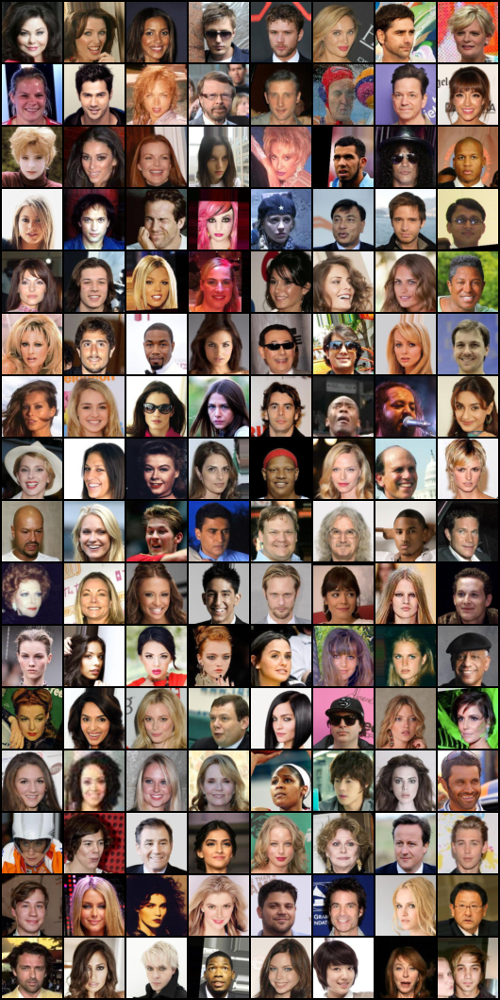

Epoch: 1


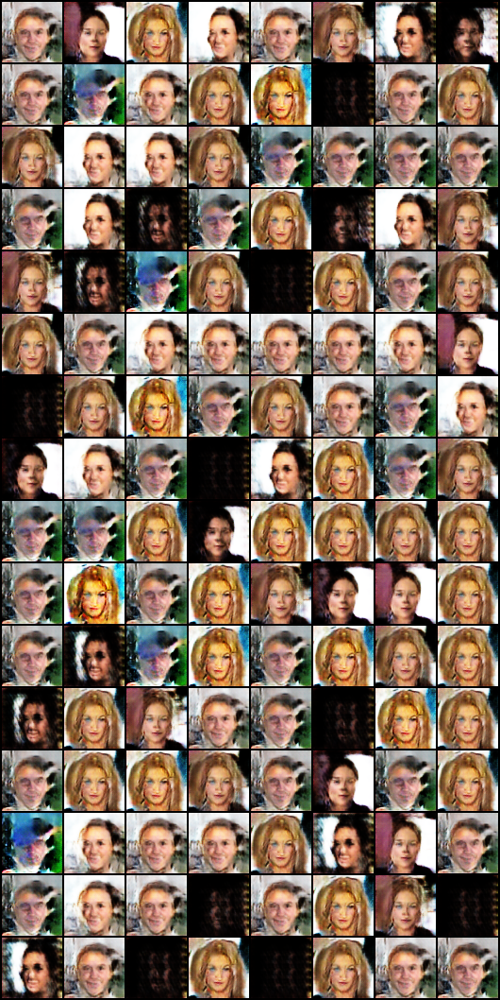

Epoch: 2


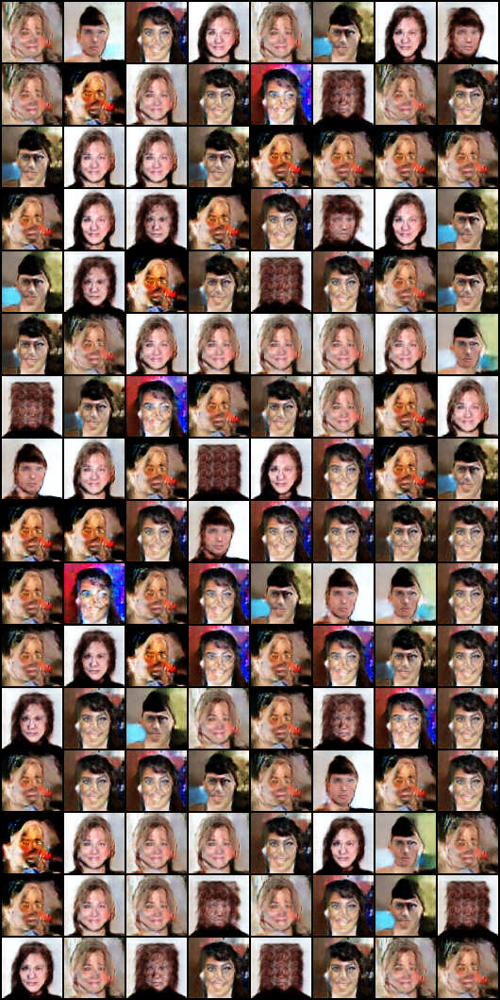

Epoch: 3


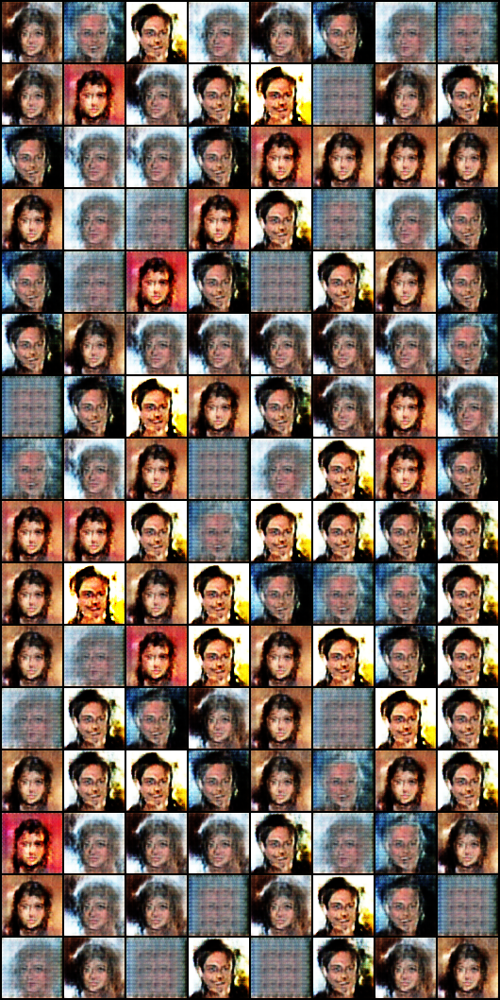

Epoch: 4


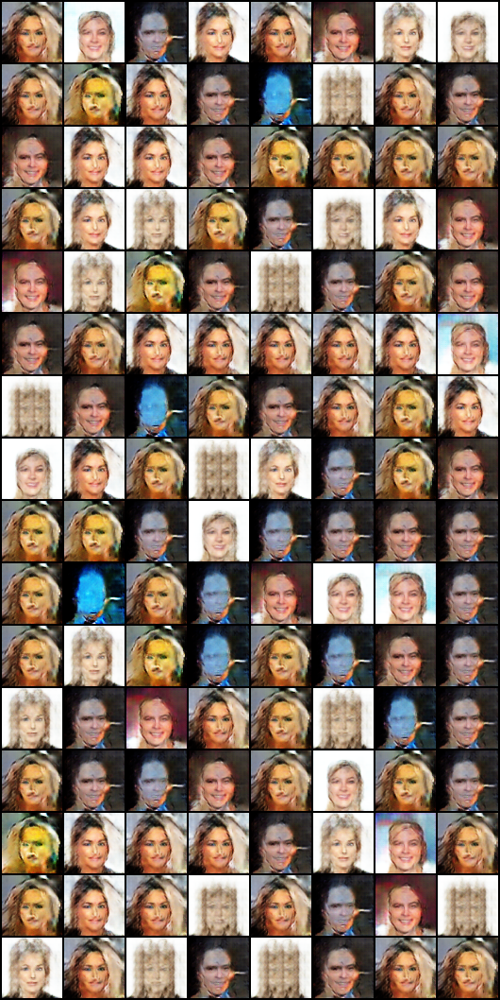

Epoch: 5


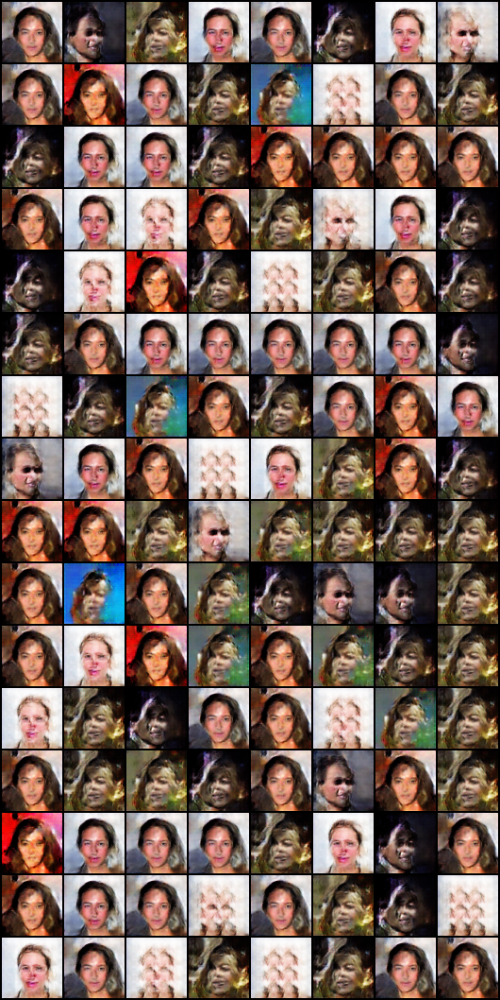

Epoch: 6


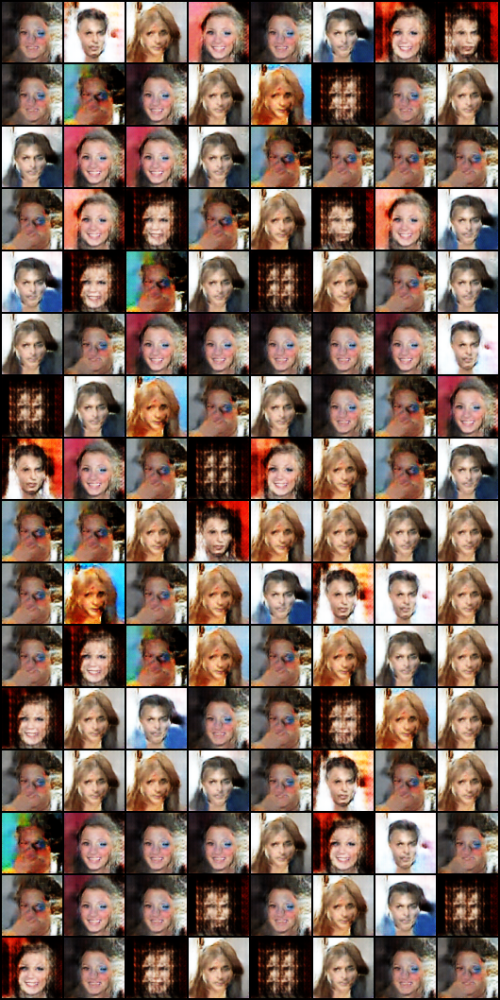

Epoch: 7


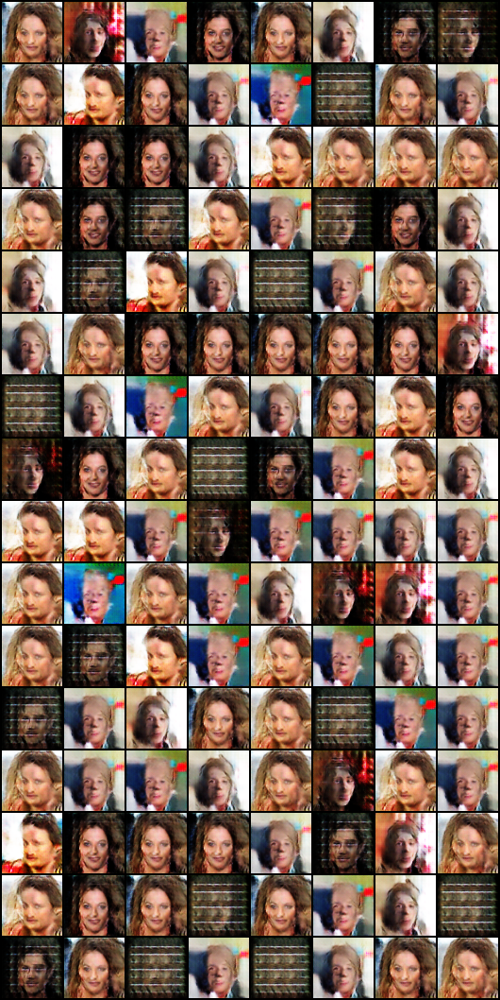

Epoch: 8


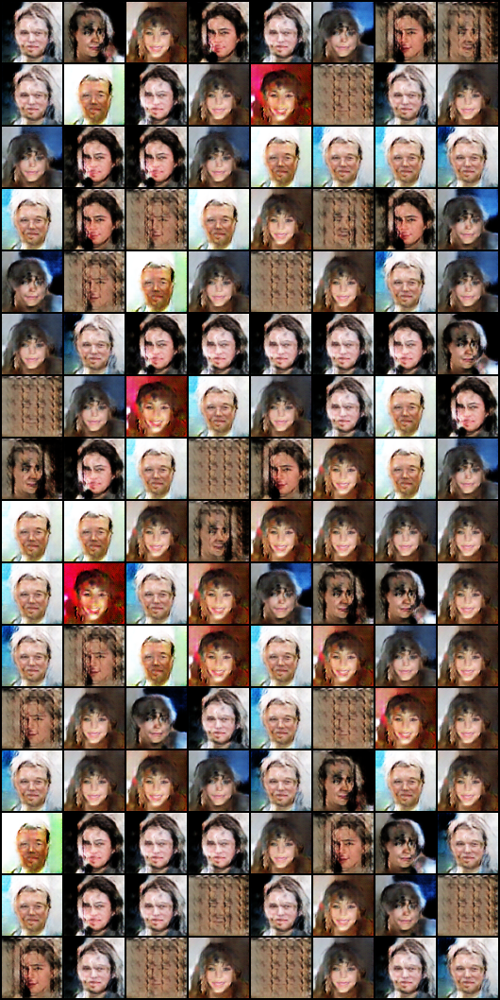

Epoch: 9


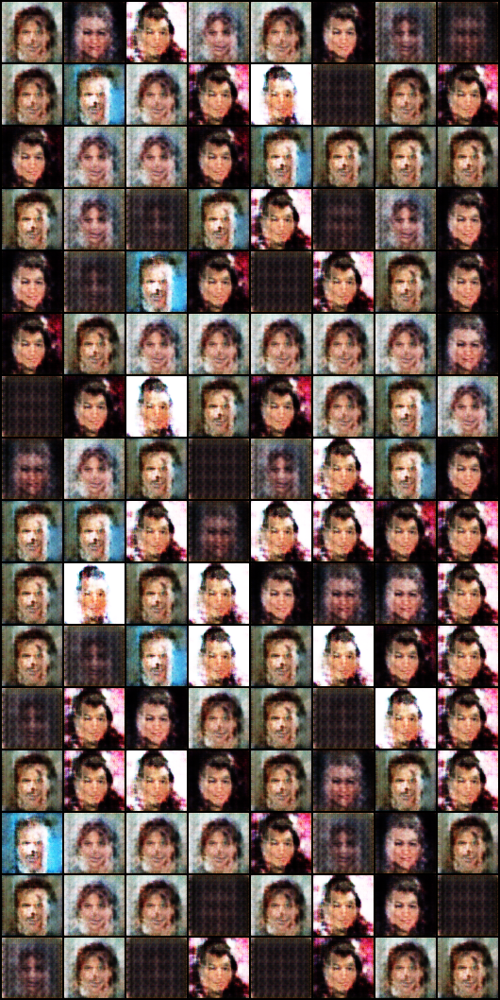

Epoch: 10


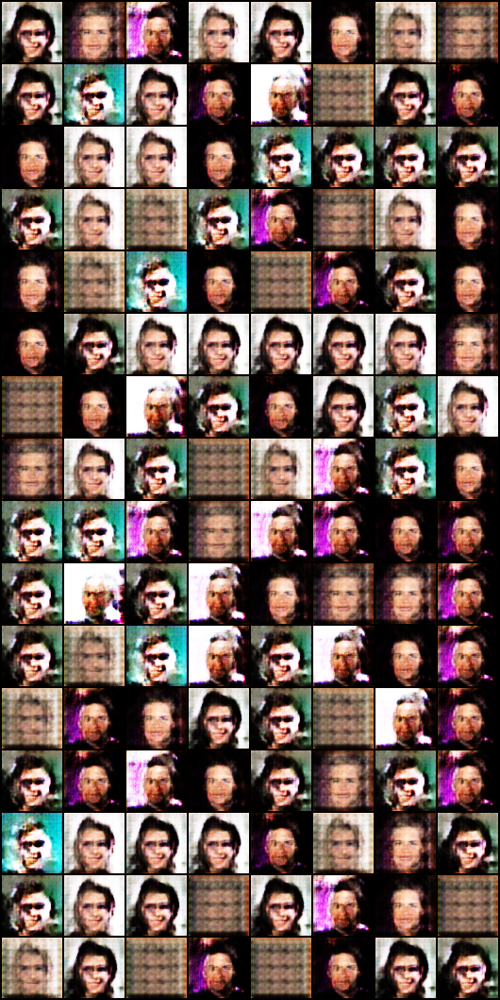

Epoch: 11


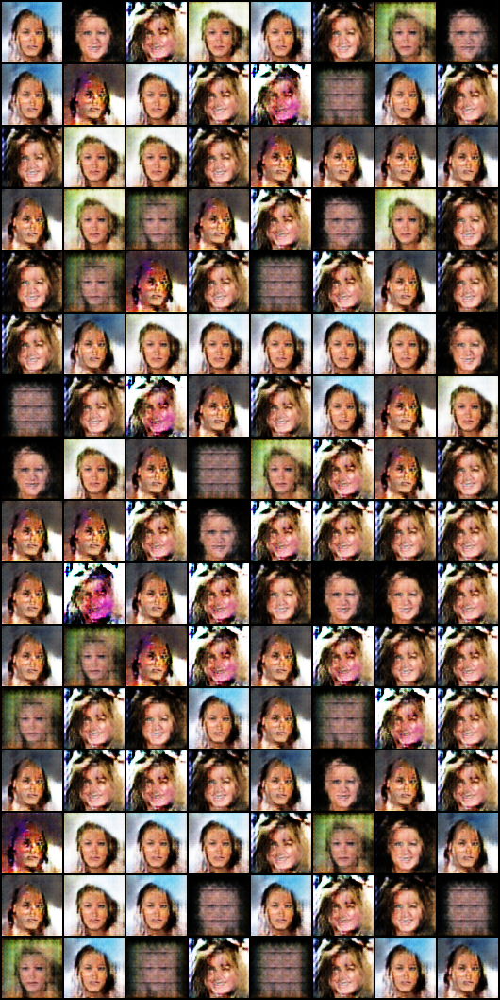

Epoch: 12


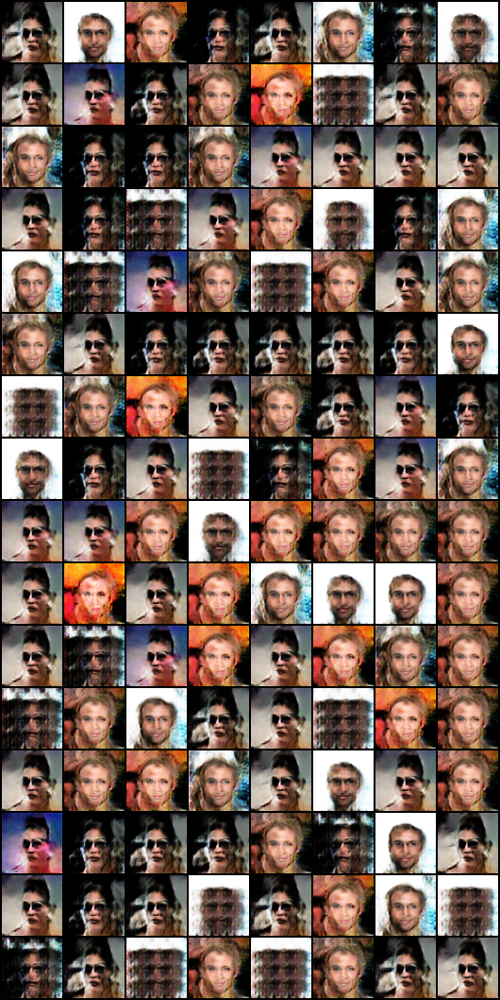

Epoch: 13


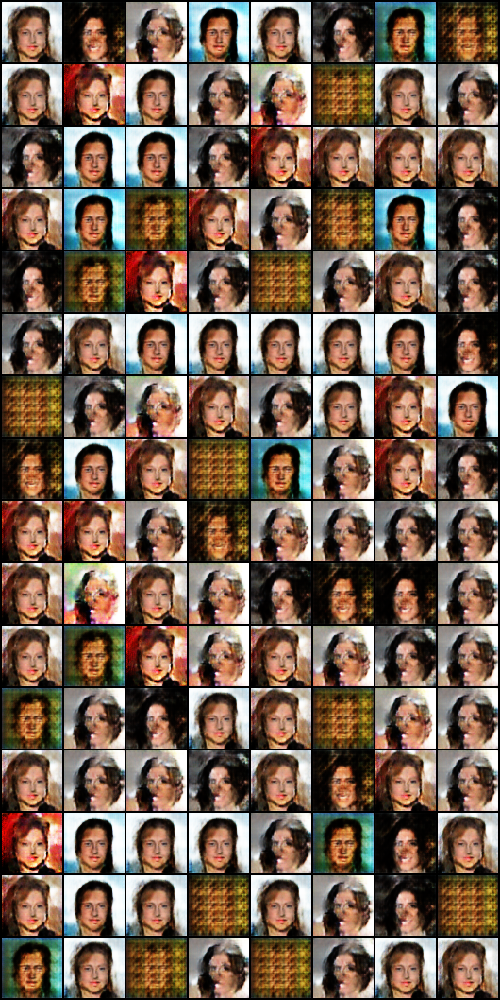

Epoch: 14


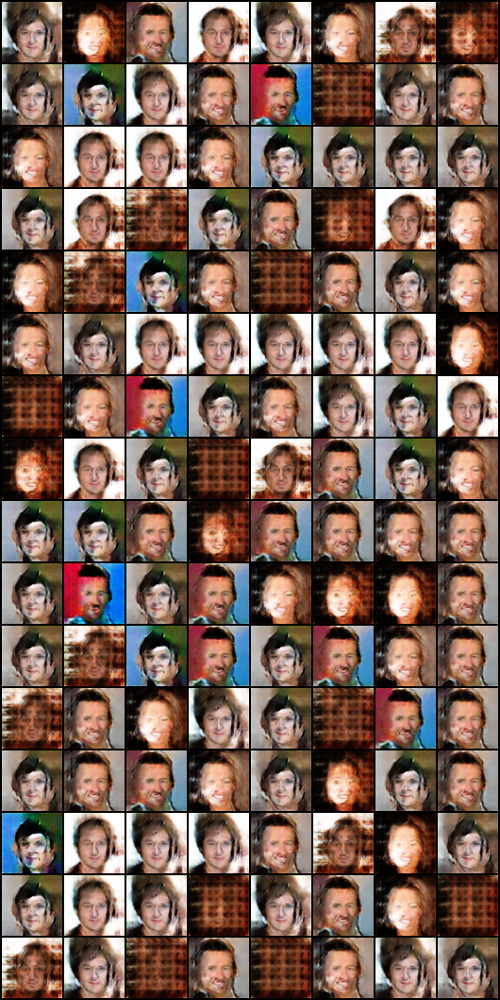

Epoch: 15


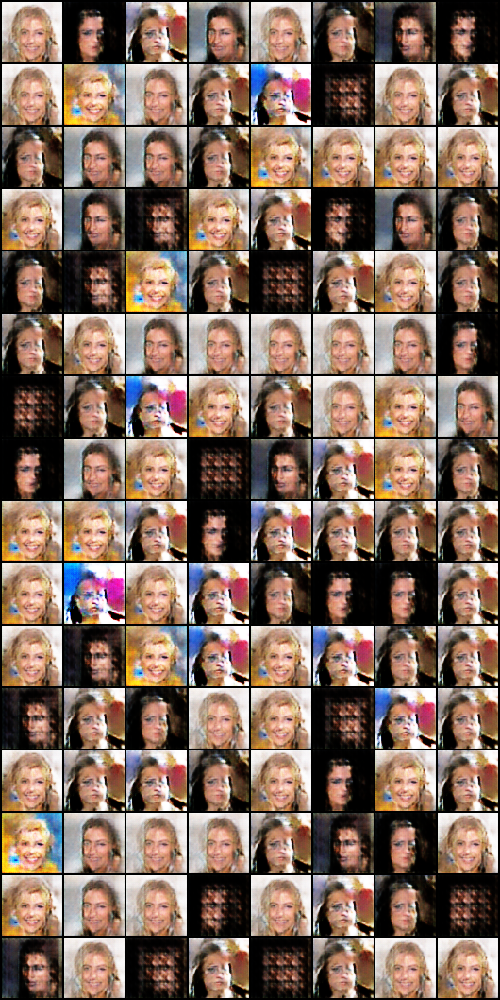

Epoch: 16


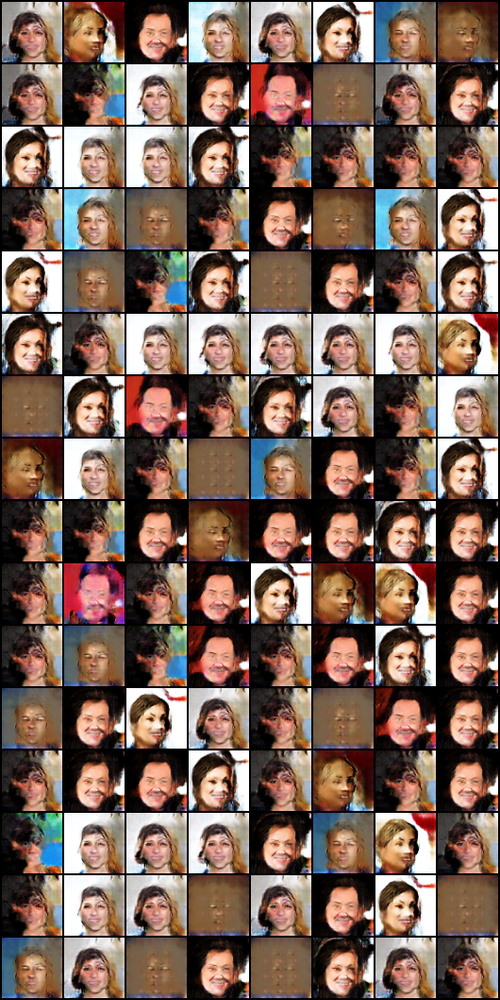

Epoch: 17


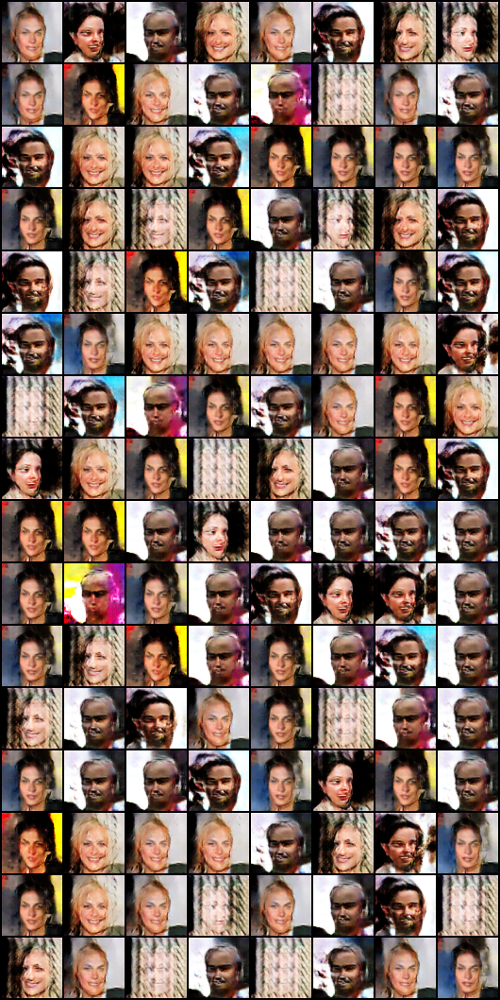

Epoch: 18


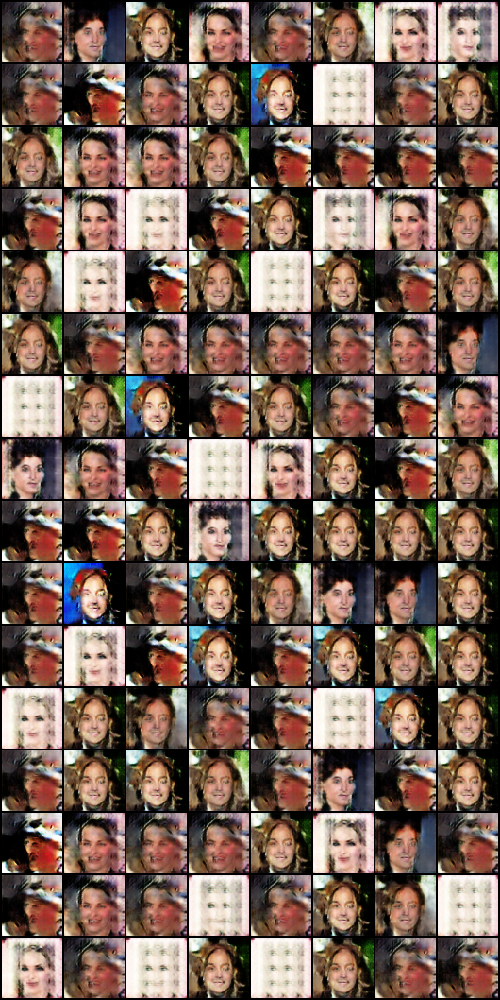

Epoch: 19


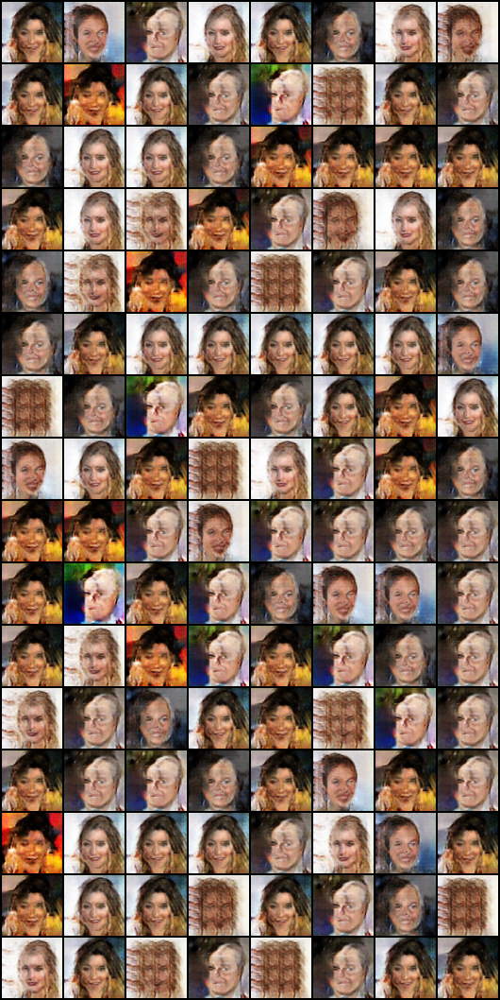

Epoch: 20


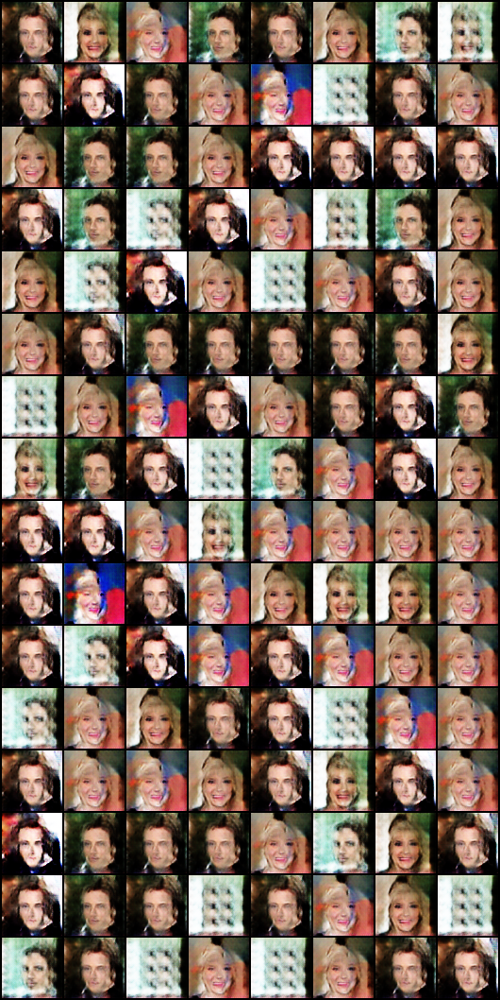

Epoch: 21


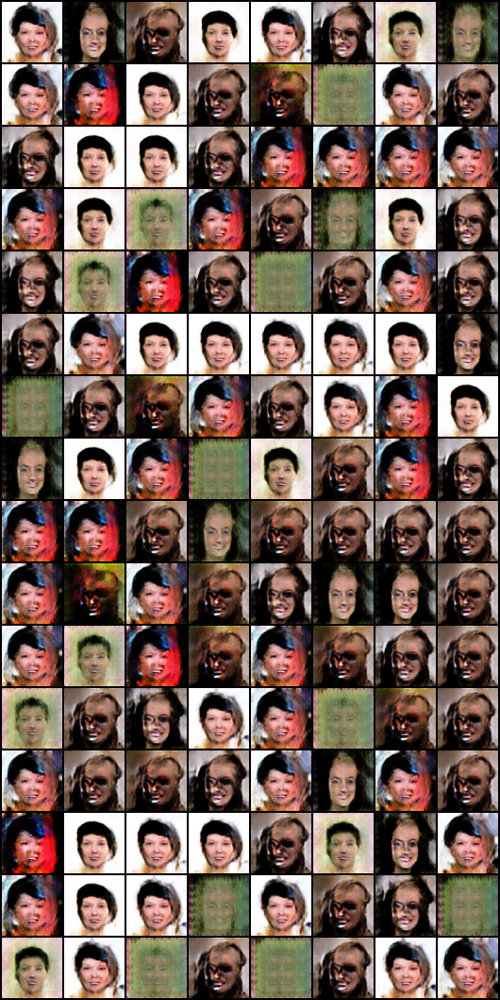

Epoch: 22


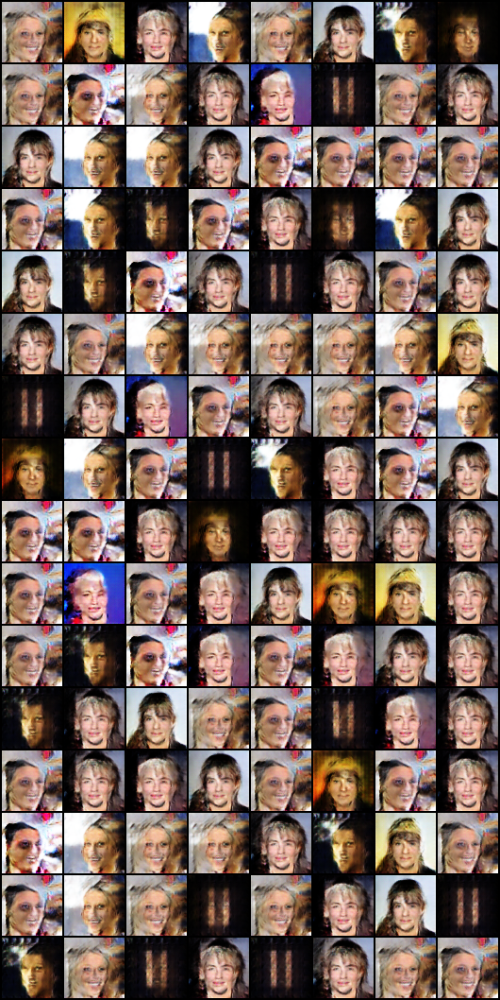

Epoch: 23


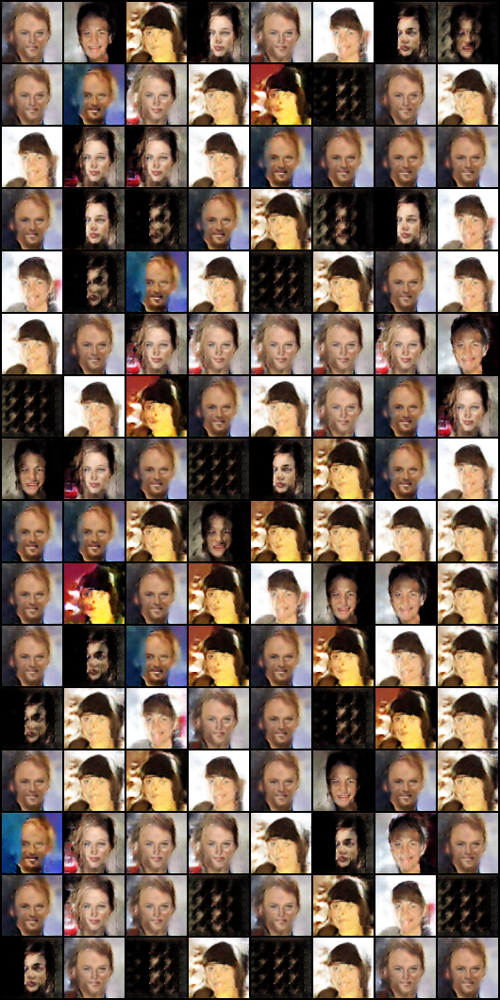

Epoch: 24


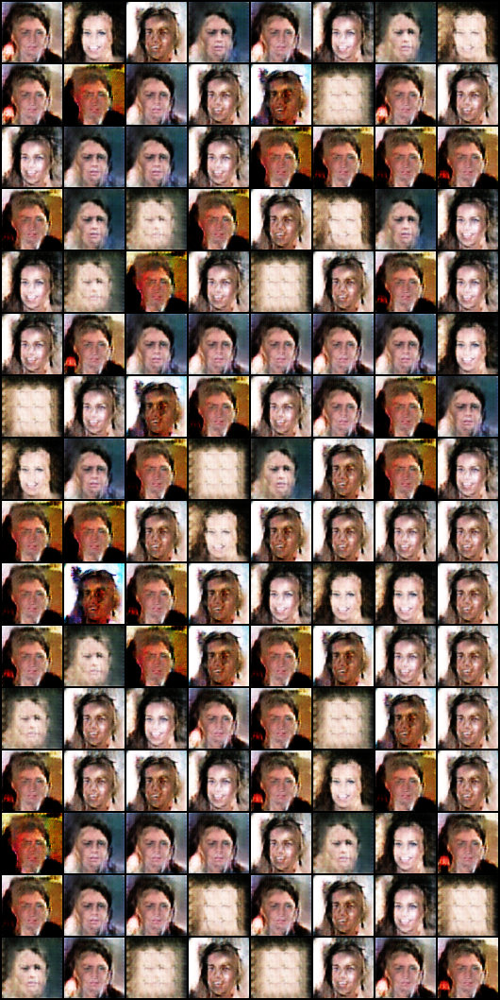

Epoch: 25


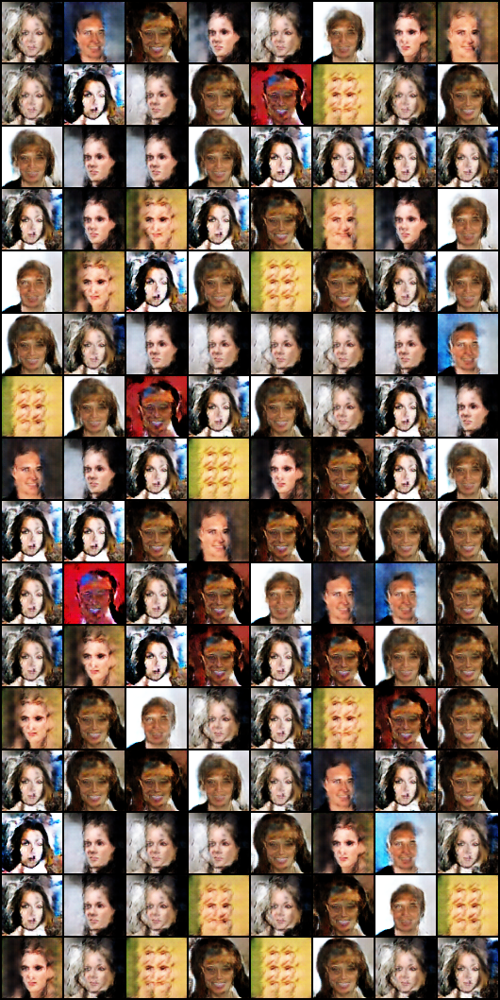

In [52]:
#from PIL import Image
from IPython.display import Image
print('Real Samples:')
im = Image('output/real_samples.png')
display(im)
i = 1
for file in os.listdir('output/'):
  if file[0] == 'f':
    print('Epoch: ' + str(i))
    #im = Image.open('output/' + file)
    im = Image('output/' + file)
    display(im)
    i += 1

Definitly need to train for much longer time